<a href="https://colab.research.google.com/github/jainriya9/DeepFake-Detection/blob/main/improvisation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
print(os.listdir('/content/drive/MyDrive/Celeb-DF'))

['List_of_testing_videos.txt', 'Celeb-synthesis', 'Celeb-real', 'YouTube-real']


In [ ]:
# Define the paths to your dataset in Google Drive
real_videos_dir = '/content/drive/MyDrive/Celeb-DF/Celeb-real'
fake_videos_dir = '/content/drive/MyDrive/Celeb-DF/Celeb-synthesis'

# Verify that the paths are correct
import os
print(os.listdir(real_videos_dir))
print(os.listdir(fake_videos_dir))

['id0_0000.mp4', 'id0_0001.mp4', 'id0_0002.mp4', 'id0_0005.mp4', 'id0_0006.mp4', 'id10_0000.mp4', 'id0_0009.mp4', 'id0_0003.mp4', 'id0_0008.mp4', 'id0_0007.mp4', 'id0_0004.mp4', 'id11_0005.mp4', 'id10_0001.mp4', 'id10_0006.mp4', 'id11_0006.mp4', 'id10_0002.mp4', 'id10_0008.mp4', 'id10_0007.mp4', 'id10_0003.mp4', 'id10_0009.mp4', 'id10_0005.mp4', 'id11_0003.mp4', 'id11_0002.mp4', 'id11_0000.mp4', 'id11_0001.mp4', 'id10_0004.mp4', 'id11_0004.mp4', 'id12_0004.mp4', 'id13_0005.mp4', 'id13_0008.mp4', 'id13_0000.mp4', 'id11_0008.mp4', 'id13_0007.mp4', 'id13_0009.mp4', 'id13_0006.mp4', 'id11_0010.mp4', 'id12_0000.mp4', 'id12_0001.mp4', 'id13_0004.mp4', 'id11_0009.mp4', 'id13_0001.mp4', 'id12_0003.mp4', 'id11_0007.mp4', 'id12_0006.mp4', 'id13_0003.mp4', 'id12_0005.mp4', 'id13_0002.mp4', 'id12_0002.mp4', 'id13_0015.mp4', 'id13_0014.mp4', 'id16_0003.mp4', 'id13_0013.mp4', 'id13_0010.mp4', 'id16_0000.mp4', 'id13_0012.mp4', 'id16_0001.mp4', 'id16_0002.mp4', 'id13_0011.mp4', 'id17_0006.mp4', 'id16_

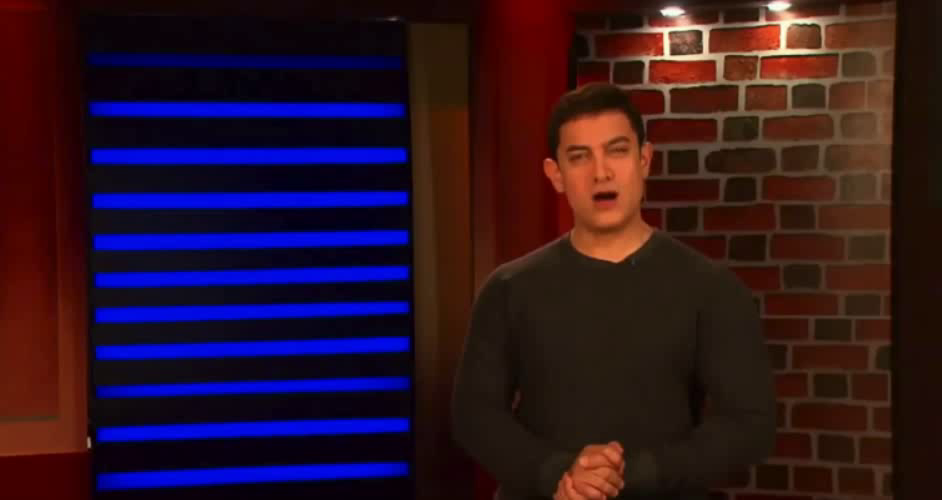

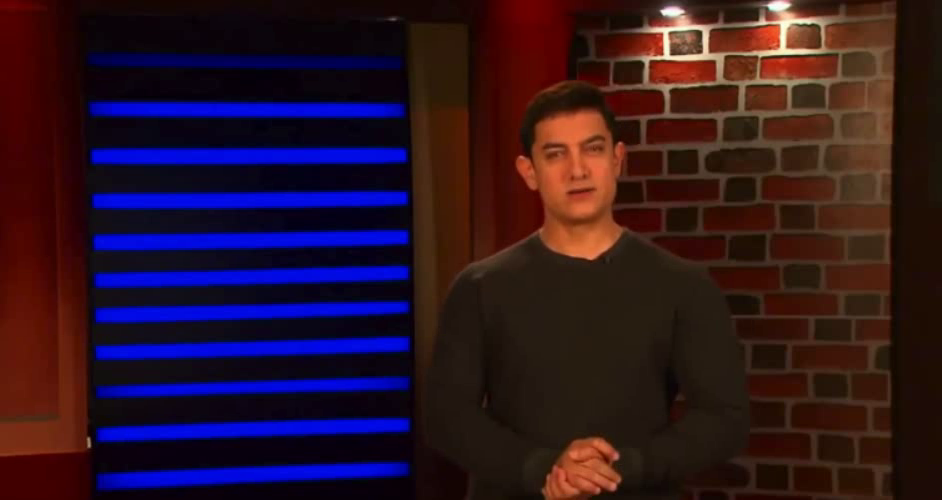

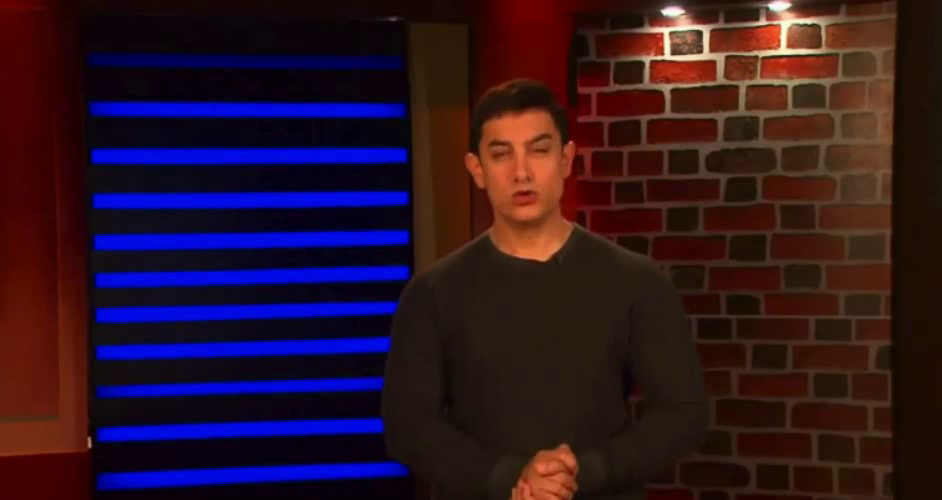

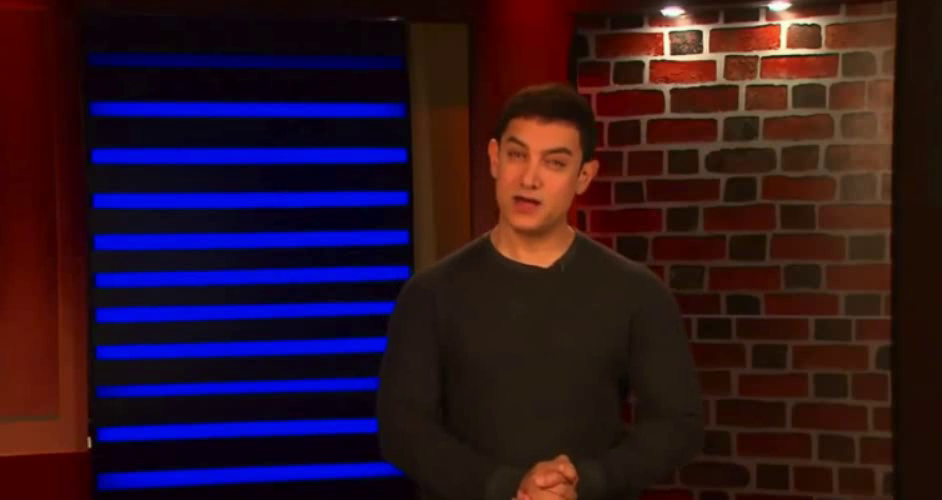

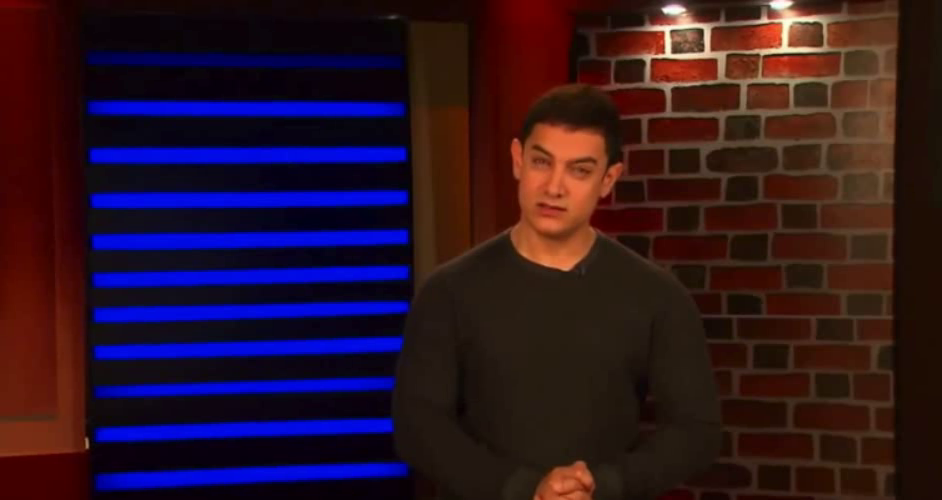

...

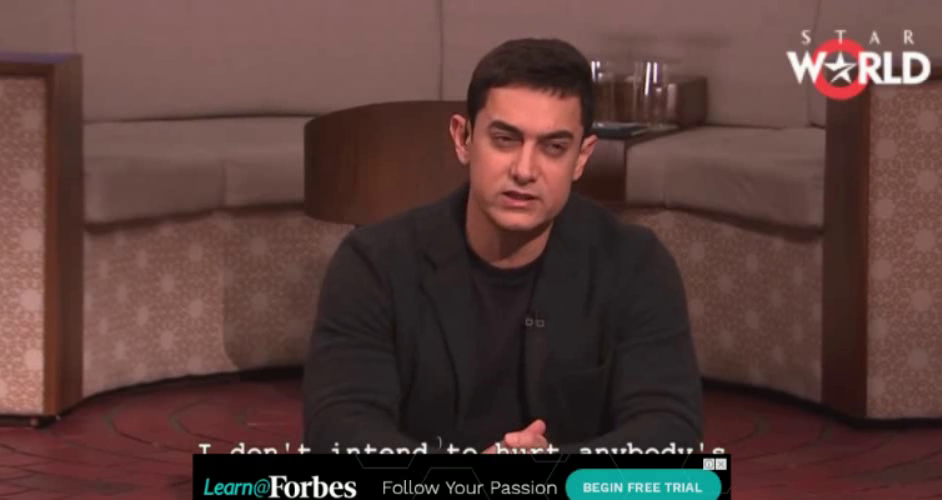

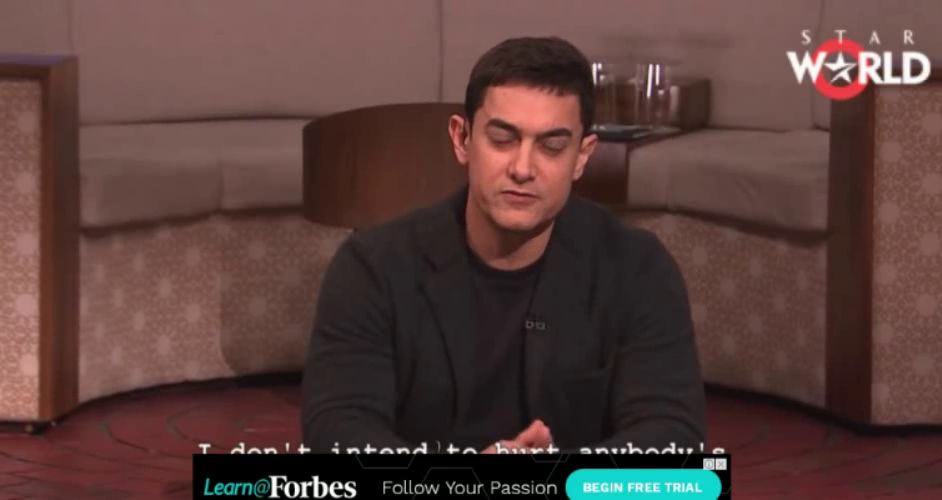

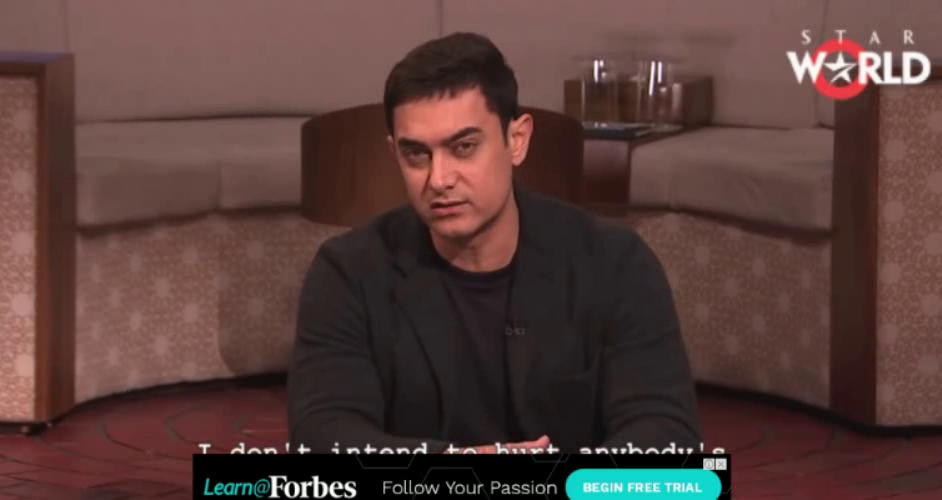

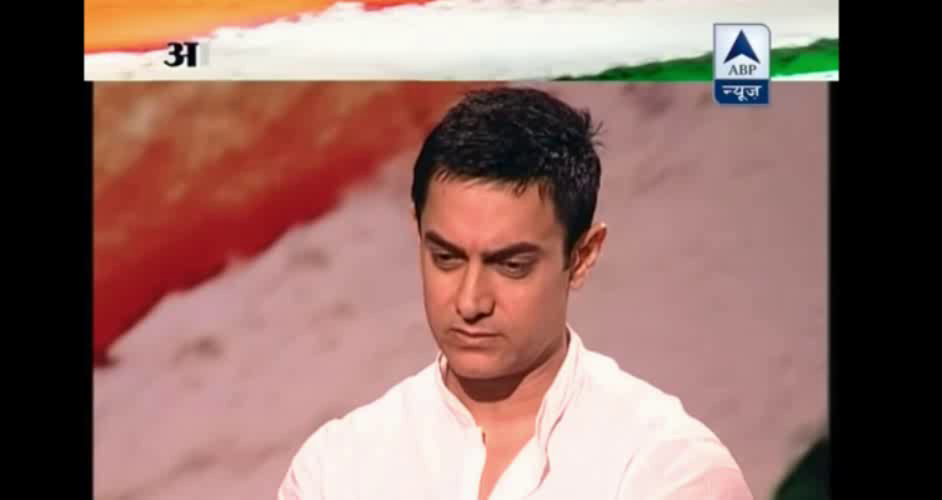

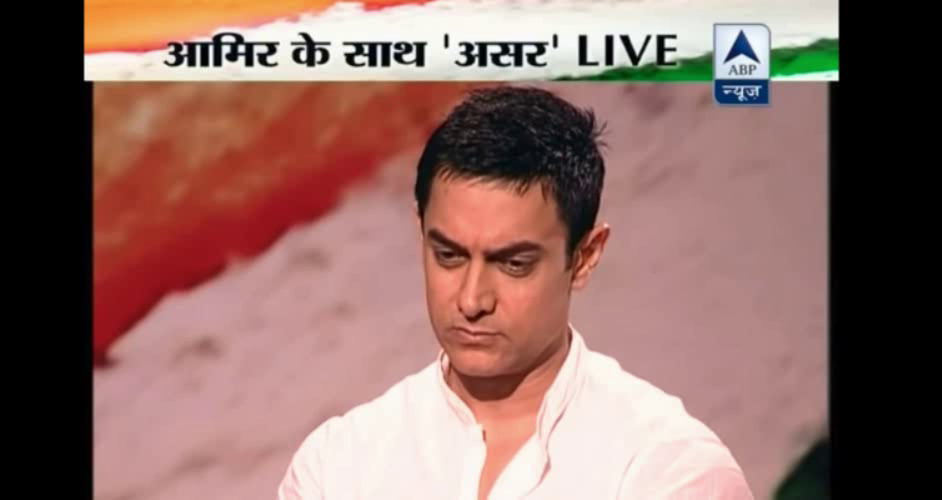

In [ ]:
import cv2
import os

def frame_generator(video_path, frame_interval=25):
    cap = cv2.VideoCapture(video_path)
    frame_count = 0
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        if frame_count % frame_interval == 0:
            yield frame
        frame_count += 1
    cap.release()

# Define the paths to your dataset in Google Drive
real_videos_dir = '/content/drive/MyDrive/Celeb-DF/Celeb-real'
fake_videos_dir = '/content/drive/MyDrive/Celeb-DF/Celeb-synthesis'

# Define a directory to save the extracted frames
output_dir = '/content/drive/MyDrive/extracted_frames'
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Get the paths to all video files in the directories
real_video_paths = [os.path.join(real_videos_dir, filename) for filename in os.listdir(real_videos_dir)]
fake_video_paths = [os.path.join(fake_videos_dir, filename) for filename in os.listdir(fake_videos_dir)]

# Process frames and save them
frame_counter = 0
for video_path in real_video_paths + fake_video_paths: # Process both real and fake videos
    for frame in frame_generator(video_path):
        output_path = os.path.join(output_dir, f'frame_{frame_counter}.jpg')
        cv2.imwrite(output_path, frame)
        frame_counter += 1

print(f"Extracted {frame_counter} frames and saved to {output_dir}")

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np

datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Flatten the list of real video frames for augmentation
real_frames = [frame for video_frames in real_video_frames for frame in video_frames]

augmented_frames = []
for frame in real_frames:
    frame = frame.reshape((1,) + frame.shape)  # Reshape to (1, height, width, channels)
    for batch in datagen.flow(frame, batch_size=1):
        augmented_frames.append(batch[0].astype('uint8'))
        if len(augmented_frames) >= len(real_frames) * 3:
            break


In [ ]:
import numpy as np
from scipy import signal
from python_speech_features import mfcc
import matplotlib.pyplot as plt

def high_pass_filter(frame):
    # Assuming frame is a grayscale image
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    f = np.fft.fft2(gray)
    fshift = np.fft.fftshift(f)
    rows, cols = gray.shape
    crow, ccol = rows // 2 , cols // 2
    fshift[crow-30:crow+30, ccol-30:ccol+30] = 0  # Remove low frequencies
    f_ishift = np.fft.ifftshift(fshift)
    img_back = np.fft.ifft2(f_ishift)
    img_back = np.abs(img_back)
    return img_back

def extract_mfcc(frame):
    # Convert frame to spectrogram
    frame_mfcc = mfcc(frame, samplerate=16000, numcep=13)
    return frame_mfcc

# Apply high-pass filter and extract MFCCs for each frame
processed_real_frames = [extract_mfcc(high_pass_filter(frame)) for frame in augmented_frames]
processed_fake_frames = [extract_mfcc(high_pass_filter(frame)) for frame in fake_video_frames]


In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Layer

class CustomEmbeddingLayer(Layer):
    def __init__(self, **kwargs):
        super(CustomEmbeddingLayer, self).__init__(**kwargs)

    def build(self, input_shape):
        super(CustomEmbeddingLayer, self).build(input_shape)

    def call(self, inputs):
        mfcc_features, fft_features = inputs
        combined_features = tf.concat([mfcc_features, fft_features], axis=-1)
        return combined_features

    def compute_output_shape(self, input_shape):
        mfcc_shape, fft_shape = input_shape
        return (mfcc_shape[0], mfcc_shape[1] + fft_shape[1])

# Create the embedding layer
custom_embedding_layer = CustomEmbeddingLayer()
